<a href="https://colab.research.google.com/github/HarlinLee/cogsci-missed-connections/blob/main/topics_comparison.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Import packages

In [ ]:
import os
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns
from plotly import express as px
import pickle
import matplotlib.ticker as mtick

from scipy.stats import kurtosis

In [ ]:
from google.colab import drive

drive.mount('/content/drive') 
DRIVE_PATH = "/content/drive/My Drive/REU evolution of scientific fields"

Mounted at /content/drive


# New data

##Preprocessing

### Load data from saved pickle file

In [ ]:
with open(os.path.join(DRIVE_PATH,'nextstep', 'NMF_before_20220224.pkl'),'rb') as f:
    nmf0, W0, H0, idx_to_word0, before_Id = pickle.load(f)

with open(os.path.join(DRIVE_PATH,'nextstep', 'NMF_all_20220224.pkl'),'rb') as f:
    nmf, W, H, idx_to_word, Id = pickle.load(f)

with open(os.path.join(DRIVE_PATH,'nextstep', 'NMF_after_20220224.pkl'),'rb') as f:
    nmf1, W1, H1, idx_to_word1, after_Id = pickle.load(f)

### Create dictionary and dataframe from loaded data

In [ ]:
id_to_topics = {}

unique, counts = np.unique(H0.argmax(axis=0), return_counts=True)
before_to_topid = dict(zip(counts.argsort() , np.arange(49,-1,-1)))
unique, counts = np.unique(H.argmax(axis=0), return_counts=True)
all_to_topid = dict(zip(counts.argsort() , np.arange(49,-1,-1)))
unique, counts = np.unique(H1.argmax(axis=0), return_counts=True)
after_to_topid = dict(zip(counts.argsort() , np.arange(49,-1,-1)))

id_to_topics['before'] =  dict(zip(before_Id, map(lambda x: before_to_topid[x], H0.argmax(axis=0))))
id_to_topics['all'] = dict(zip(Id, map(lambda x: all_to_topid[x], H.argmax(axis=0))))
id_to_topics['after'] =  dict(zip(after_Id, map(lambda x: after_to_topid[x], H1.argmax(axis=0))))


topic_to_keywords = {}
topic_to_keywords['before'] = {before_to_topid[i]:list(idx_to_word0[topic.argsort()[:-11:-1].astype(int)]) for i, topic in enumerate(W0.T)}
topic_to_keywords['all'] = {all_to_topid[i]:list(idx_to_word[topic.argsort()[:-11:-1].astype(int)]) for i, topic in enumerate(W.T)}
topic_to_keywords['after'] = {after_to_topid[i]:list(idx_to_word1[topic.argsort()[:-11:-1].astype(int)]) for i, topic in enumerate(W1.T)}


topics_df = pd.DataFrame(index = Id)
topics_df['TopicId_before'] = topics_df.index.map(id_to_topics['before'])
topics_df['TopicKeywords_before'] = topics_df.TopicId_before.map(topic_to_keywords['before'])
topics_df['TopicId_all'] = topics_df.index.map(id_to_topics['all'])
topics_df['TopicKeywords_all'] = topics_df.TopicId_all.map(topic_to_keywords['all'])
topics_df['TopicId_after'] = topics_df.index.map(id_to_topics['after'])
topics_df['TopicKeywords_after'] = topics_df.TopicId_after.map(topic_to_keywords['after'])

# before_to_ID = dict((topics_df.TopicId_before.value_counts().argsort() - 49) * (-1))
# all_to_ID = dict((topics_df.TopicId_all.value_counts().argsort() - 49) * (-1))
# after_to_ID = dict((topics_df.TopicId_after.value_counts().argsort() - 49) * (-1))

# topics_df['TopicId_before'] = topics_df.TopicId_before.map(before_to_ID)
# topics_df['TopicId_all'] = topics_df.TopicId_all.map(all_to_ID)
# topics_df['TopicId_after'] = topics_df.TopicId_after.map(after_to_ID)

In [ ]:
topics_df.head()

,TopicId_before,TopicKeywords_before,TopicId_all,TopicKeywords_all,TopicId_after,TopicKeywords_after
Id,,,,,,
1999653836,1.0,"[brain, function, neuroscience, neural, activi...",39,"[network, dynamic, complex, functional, connec...",NaN,NaN
10833075,NaN,NaN,7,"[learning, learn, learner, student, environmen...",6.0,"[learning, learn, learner, child, education, e..."
2163480486,4.0,"[cell, biological, biology, life, gene, molecu...",2,"[cell, biological, biology, life, disease, mol...",NaN,NaN
3022532439,19.0,"[action, motor, intention, goal, imitation, mi...",41,"[action, motor, goal, intention, mirror_neuron...",NaN,NaN
2439568532,NaN,NaN,1,"[model, propose, modeling, describe, based, me...",4.0,"[model, propose, based, modeling, computationa..."


In [ ]:
## Fill NA and extract top keywords for ploting 
topics_df = topics_df.fillna(value={'TopicKeywords_before':'None', 'TopicKeywords_all':'None','TopicKeywords_after':'None'})
topics_df['Super3_before'] = topics_df['TopicKeywords_before'].apply(lambda x: ', '.join(x[:3]) if x != 'None' else x)
topics_df['Super3_all'] = topics_df['TopicKeywords_all'].apply(lambda x: ', '.join(x[:3]) if x != 'None' else x)
topics_df['Super3_after'] = topics_df['TopicKeywords_after'].apply(lambda x: ', '.join(x[:3]) if x != 'None' else x)

In [ ]:
topics_df.head()

,TopicId_before,TopicKeywords_before,TopicId_all,TopicKeywords_all,TopicId_after,TopicKeywords_after,Super3_before,Super3_all,Super3_after
Id,,,,,,,,,
1999653836,1.0,"[brain, function, neuroscience, neural, activi...",39,"[network, dynamic, complex, functional, connec...",NaN,None,"brain, function, neuroscience","network, dynamic, complex",None
10833075,NaN,None,7,"[learning, learn, learner, student, environmen...",6.0,"[learning, learn, learner, child, education, e...",None,"learning, learn, learner","learning, learn, learner"
2163480486,4.0,"[cell, biological, biology, life, gene, molecu...",2,"[cell, biological, biology, life, disease, mol...",NaN,None,"cell, biological, biology","cell, biological, biology",None
3022532439,19.0,"[action, motor, intention, goal, imitation, mi...",41,"[action, motor, goal, intention, mirror_neuron...",NaN,None,"action, motor, intention","action, motor, goal",None
2439568532,NaN,None,1,"[model, propose, modeling, describe, based, me...",4.0,"[model, propose, based, modeling, computationa...",None,"model, propose, modeling","model, propose, based"


## Visualizations

In [ ]:
fig = px.pie(topics_df.dropna(subset = ['TopicId_before']), 
            #  values='TopicId_before', 
             names= 'Super3_before',
            #  color = 'TopicId_before',
            #  title= 'Pie Chart of Topics before 2012'
             )
fig.update_traces(textposition='inside', textinfo='percent+label', showlegend=False)
fig.show()

In [ ]:
fig = px.pie(topics_df.dropna(subset=['TopicId_all']), 
            #  values='TopicId_all', 
             names= 'Super3_all',
            #  title= 'Pie Chart of Topics overall'
             )
fig.update_traces(textposition='inside', textinfo='percent+label', showlegend=False)
fig.show()

In [ ]:
fig = px.pie(topics_df.dropna(subset=['TopicId_after']), 
            #  values='TopicId_after', 
             names= 'Super3_after',
            #  title= 'Pie Chart of Topics overall'
             )
fig.update_traces(textposition='inside', textinfo='percent+label', showlegend=False)
fig.show()

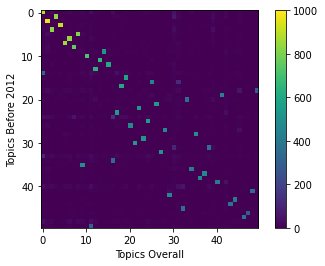

In [ ]:
plt.imshow(pd.crosstab(topics_df.TopicId_before, topics_df.TopicId_all))
plt.xlabel("Topics Overall")
plt.ylabel("Topics Before 2012")
plt.colorbar()
plt.clim(0, 1000) 

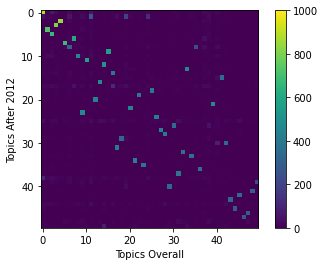

In [ ]:
plt.imshow(pd.crosstab(topics_df.TopicId_after, topics_df.TopicId_all))
plt.xlabel("Topics Overall")
plt.ylabel("Topics After 2012")
plt.colorbar()
plt.clim(0, 1000) 

Text(0, 0.5, 'Topics After 2012')

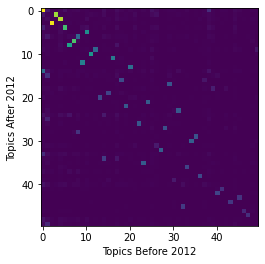

In [ ]:
plt.imshow(pd.crosstab(topics_df.TopicId_before, topics_df.TopicId_all) @ pd.crosstab(topics_df.TopicId_after, topics_df.TopicId_all).T)
plt.xlabel("Topics Before 2012")
plt.ylabel("Topics After 2012")

## Function Definitions

In [ ]:
#### map topic words
def map_topic_words(TopicId1, TopicId2, Topic_to_keywords1, Topic_to_keywords2, sort_id = True):
  word_1_to_2 = {i:{} for i in Topic_to_keywords1}

  if sort_id:
      TopicId_21_crosstab = pd.crosstab(TopicId2, TopicId1)
      # TopicId_1_to_2 = TopicId_21_crosstab.apply(lambda x: x.argmax(), axis = 0)

      for id, topic_words1 in Topic_to_keywords1.items():
          ids_2 = TopicId_21_crosstab[id].argsort()[::-1]
          for j, word in enumerate(topic_words1):
              word_1_to_2[id][word] = []
              for i in ids_2:
                if word in Topic_to_keywords2[i]:
                    word_1_to_2[id][word].append( (i, Topic_to_keywords2[i].index(word)) )
    
    
  else:
      for id, topic_words1 in Topic_to_keywords1.items():
          for j, word in enumerate(topic_words1):
              word_1_to_2[id][word] = []
              for i, topic_words2 in Topic_to_keywords2.items():
                  if word in topic_words2:
                    word_1_to_2[id][word].append( (i, topic_words2.index(word)) )
  return word_1_to_2


def id_map_topic_words(topic_type_1, topic_type_2, topic_id):
  topic_types = ['before', 'all', 'after']

  if topic_type_1 not in topic_types:
        raise ValueError("Invalid topic_type_1. Expected one of: %s" % topic_types)

  if topic_type_2 not in topic_types:
        raise ValueError("Invalid topic_type_2. Expected one of: %s" % topic_types)

  if 'before' in (topic_type_1, topic_type_2) and 'after' in (topic_type_1, topic_type_2):
    word_1_to_2 = map_topic_words(topics_df['TopicId_' + topic_type_1], 
                                topics_df['TopicId_' + topic_type_2], 
                                topic_to_keywords[topic_type_1], 
                                topic_to_keywords[topic_type_2], 
                                sort_id=False)
  else:
    word_1_to_2 = map_topic_words(topics_df['TopicId_' + topic_type_1], 
                                topics_df['TopicId_' + topic_type_2], 
                                topic_to_keywords[topic_type_1], 
                                topic_to_keywords[topic_type_2], 
                                sort_id=True)
  return  word_1_to_2[topic_id]


In [ ]:
## get attributes of paper & make plots
with open(os.path.join(DRIVE_PATH, 'filtered_new_fields_df.pkl'), 'rb') as file:
    fields_df = pickle.load(file)
print(fields_df.shape)

id_to_published_in = dict(zip(fields_df['Id'], 
                              fields_df['J'].apply(lambda x: x['JN'] if isinstance(x, dict) else [])))
id_to_affili_name = dict(zip(fields_df['Id'], 
                             fields_df['AA'].apply(lambda x: [y['AfN'] for y in x if 'AfN' in y] if isinstance(x, list) and len(x) > 0 else []) ))
id_to_affili_Id = dict(zip(fields_df['Id'], 
                           fields_df['AA'].apply(lambda x: [y['AfId'] for y in x if 'AfId' in y] if isinstance(x, list) and len(x) > 0 else []) ))
id_to_author_name = dict(zip(fields_df['Id'], 
                             fields_df['AA'].apply(lambda x: [y['AuN'] for y in x if 'AuN' in y] if isinstance(x, list) and len(x) > 0 else []) ))
id_to_author_Id = dict(zip(fields_df['Id'], 
                           fields_df['AA'].apply(lambda x: [y['AuId'] for y in x if 'AuId' in y] if isinstance(x, list) and len(x) > 0 else []) ))
id_to_year = dict(zip(fields_df['Id'],fields_df['Y']))
del fields_df

(59384, 18)


In [ ]:
# plot affiliations
affilis_df = []
for id, affilis in id_to_affili_name.items():
  for affili in affilis:
    affilis_df.append([affili, id, id_to_year[id]])

affilis_df = pd.DataFrame(affilis_df)
affilis_df = affilis_df.rename(columns={0:"affiliation",
                                            1:'paper_id',
                                            2:'year'})

affilis_df['TopicId_before'] = affilis_df.paper_id.map(id_to_topics['before'])
affilis_df['TopicId_all'] = affilis_df.paper_id.map(id_to_topics['all'])
affilis_df['TopicId_after'] = affilis_df.paper_id.map(id_to_topics['after'])

def plot_affili_hist(affili_name, **kwargs):
  return affilis_df[affilis_df['affiliation'] == affili_name].year.hist(**kwargs)

def plot_affili_ratio(affili_name, **kwargs):
  gb = affilis_df.groupby(['year'])
  affili_years = gb.apply(lambda x: sum(x['affiliation'] == affili_name))
  years = gb.size()
  fig, ax = plt.subplots(1, figsize=(6,4))
  ax.bar(years.index, affili_years/years, **kwargs)
  ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))
  ax.set_xlabel('Publication Year')
  ax.set_ylabel('Percentage of papers published')
  return fig, ax

In [ ]:
## plot authors
authors_df = []
for id, authors in id_to_author_name.items():
  for author in authors:
    authors_df.append([author, id, id_to_year[id]])

authors_df = pd.DataFrame(authors_df)
authors_df = authors_df.rename(columns={0:"author",
                                            1:'paper_id',
                                            2:'year'})

authors_df['TopicId_before'] = authors_df.paper_id.map(id_to_topics['before'])
authors_df['TopicId_all'] = authors_df.paper_id.map(id_to_topics['all'])
authors_df['TopicId_after'] = authors_df.paper_id.map(id_to_topics['after'])

def plot_author_hist(author_name, **kwargs):
  return authors_df[authors_df['author'] == author_name].year.hist(**kwargs)

def plot_author_ratio(author_name, **kwargs):
  gb = authors_df.groupby(['year'])
  author_years = gb.apply(lambda x: sum(x['author'] == author_name))
  years = gb.size()
  fig, ax = plt.subplots(1, figsize=(6,4))
  ax.bar(years.index, author_years/years, **kwargs)
  ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))
  ax.set_xlabel('Publication Year')
  ax.set_ylabel('Percentage of papers published')
  return fig, ax

In [ ]:
## to get attributs of papers 

#Returns list of journals in given list of paper_ids
def list_journals(paper_ids):
  comm_journals = [id_to_published_in[i] for i in paper_ids]
  comm_journals = [i for i in comm_journals if not isinstance(i,list)]
  return comm_journals

def list_affili_names(paper_ids):
  affili_names = [name for i in paper_ids for name in id_to_affili_name[i]]
  return affili_names

def list_author_names(paper_ids):
  author_names = [name for i in paper_ids for name in id_to_author_name[i]]
  return author_names

def list_year_published(paper_ids):
  years = [id_to_year[i] for i in paper_ids ]
  return years

def get_paper_ids_in_topic(TopicId_series, topic_id):
  '''
  TopicId_series: topic ids indexed with paper ids
  topic_id: id of topics to show
  '''
  return TopicId_series.index[TopicId_series == topic_id]


def print_topic_summary(topic_type='before', topic_id=0):

  topic_types = ['before', 'all', 'after']
  if topic_type not in topic_types:
        raise ValueError("Invalid sim type. Expected one of: %s" % topic_types)

  print(f"\n---=======Topic {topic_id} in {topic_type}=======---")
  # TopicId_series, topic_to_keywords
  # topic_df.TopicId_before

  print("\n=======Topic Keywords=======")
  print(topic_to_keywords[topic_type][topic_id])

  paper_ids = get_paper_ids_in_topic(topics_df['TopicId_'+ topic_type], topic_id)

  print("\n=======Topic Number of papers=======")
  print(len(paper_ids))

  print("\n=======Topic Journals=======")
  js = list_journals(paper_ids)
  print(pd.Series(js).value_counts()[:10])

  print("\n=======Topic Affiliations=======")
  affilis = list_affili_names(paper_ids)
  print(pd.Series(affilis).value_counts()[:10])

  print("\n=======Topic Authors=======")
  authors = list_author_names(paper_ids)
  print(pd.Series(authors).value_counts()[:10])

  print("\n=======Year Published=======")
  plt.figure()
  years = list_year_published(paper_ids)
  plt.hist(years, bins = (max(years)-min(years)+1))
  plt.title("Histogram of Years Papers Published in")

In [ ]:
#print topic composition
def get_topic_composition(topic_type_1, topic_type_2, topic_id):
  '''
  Get percentage composition of topic_type_2 in given topic in topic_type_1
  '''
  topic_21_crosstab = pd.crosstab(topics_df['TopicId_' + topic_type_2] , topics_df['TopicId_' + topic_type_1])
  return topic_21_crosstab[topic_id]

def print_topic_composition(topic_type_1, topic_type_2, topic_id, max_count=5, max_words=5):
  freqs = get_topic_composition(topic_type_1, topic_type_2, topic_id)
  freqs = freqs.sort_values(ascending = False)
  
  paper_ids = get_paper_ids_in_topic(topics_df['TopicId_'+ topic_type_1], topic_id)
  freqs = freqs/len(paper_ids) * 100

  for id2, percent in freqs.iloc[:max_count].items():
    print(f"Topic {id2}:","{:.2f}%".format(percent), topic_to_keywords[topic_type_2][id2][:max_words], '\n')

#### Examples

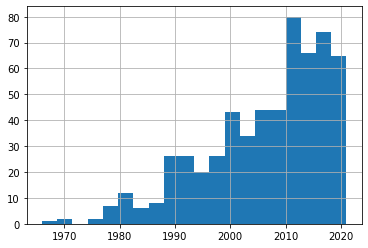

In [ ]:
plot_affili_hist('carnegie mellon university', bins = 20)

(<Figure size 432x288 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f8953452fd0>)

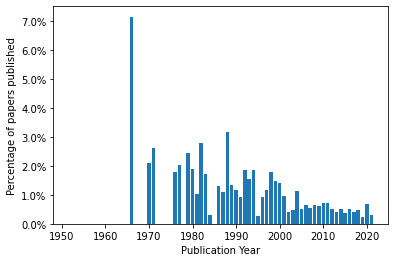

In [ ]:
plot_affili_ratio('carnegie mellon university')

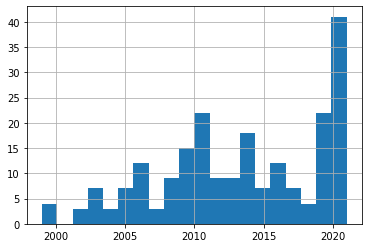

In [ ]:
plot_affili_hist('chinese academy of sciences', bins=20)

(<Figure size 432x288 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f8953794410>)

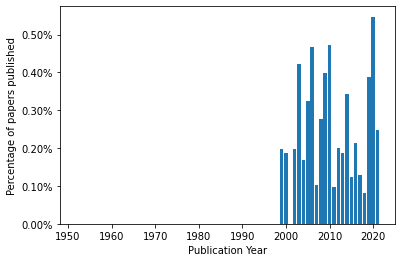

In [ ]:
plot_affili_ratio('chinese academy of sciences')

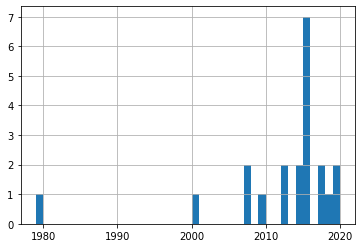

In [ ]:
plot_affili_hist('indian statistical institute', bins=np.arange(1979,2021))

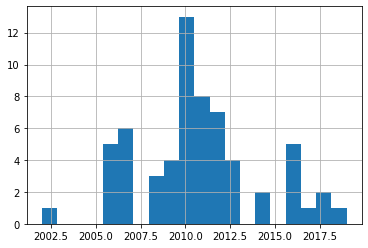

In [ ]:
plot_author_hist('leonid perlovsky',bins=20)

(<Figure size 432x288 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f8953d88ad0>)

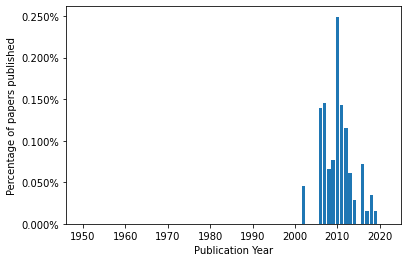

In [ ]:
plot_author_ratio('leonid perlovsky')


---=======Topic 0 in before=======---

=======Topic Keywords=======
['review', 'issue', 'area', 'recent', 'current', 'clinical', 'theoretical', 'literature', 'book', 'contribution']

=======Topic Number of papers=======
1247

=======Topic Journals=======
trends in cognitive sciences                   17
neuron                                         11
cognitive neuropsychology                       8
educational psychology review                   8
intelligence sigart bulletin                    7
behavioral and brain sciences                   7
annual review of physiology                     7
developmental review                            7
journal of the history of the neurosciences     6
cell                                            6
dtype: int64

=======Topic Affiliations=======
harvard university                   36
national institutes of health        24
university of cambridge              23
stanford university                  22
university college london            

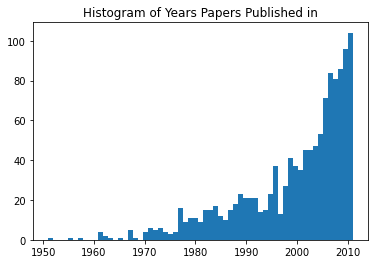

In [ ]:
print_topic_summary('before', 0)

## Find topics of change

In [ ]:
from scipy.stats import kurtosis
def plot_kurtosis(topic_type_1, topic_type_2):
  crosstab0 = pd.crosstab(topics_df['TopicId_'+topic_type_1], topics_df['TopicId_'+topic_type_2])
  kurtosis_scores = crosstab0.apply(kurtosis, fisher=True, axis = 0).sort_values()
  ids = kurtosis_scores.index[kurtosis_scores < 10].astype(int)
  sns.barplot(x = kurtosis_scores.index, y = 1/kurtosis_scores, color = 'grey')
  plt.bar(x = ids, height = 1/kurtosis_scores[ids], color = 'purple')

  labels = [''] * 50
  for i in ids:
    labels[i] = i
  frame1 = plt.gca()
  frame1.axes.xaxis.set_ticklabels(labels)
  plt.ylabel('1/Kurtosis Score w/ distribution topics' + topic_type_1)
  plt.xlabel(topic_type_2 + ' Topic Id')

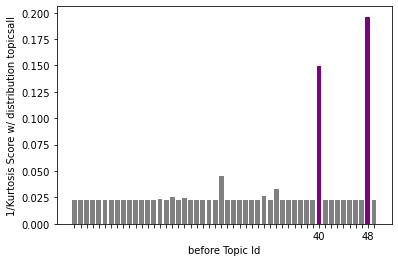

In [ ]:
plot_kurtosis('all','before')

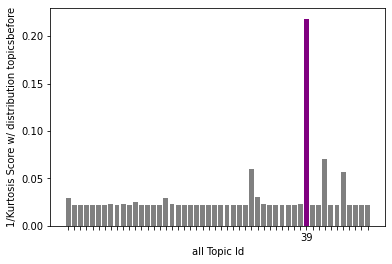

In [ ]:
plot_kurtosis('before','all')

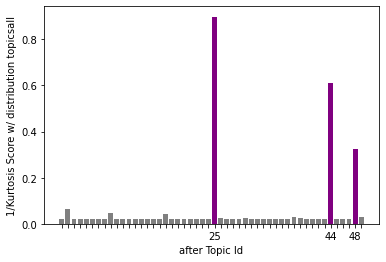

In [ ]:
plot_kurtosis('all','after')

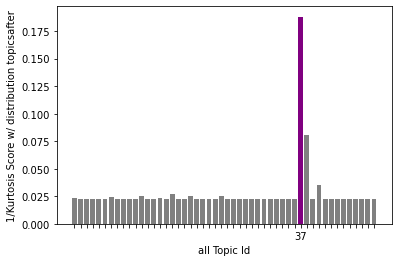

In [ ]:
plot_kurtosis('after','all')


---=======Topic 44 in after=======---

=======Topic Keywords=======
['interaction', 'context', 'dynamic', 'environment', 'embodied', 'interactive', 'individual', 'activity', 'perspective', 'multimodal']

=======Topic Number of papers=======
361

=======Topic Journals=======
frontiers in psychology                 13
frontiers in human neuroscience          7
journal of pragmatics                    6
behavioral and brain sciences            5
trends in cognitive sciences             4
topics in cognitive science              4
synthese                                 3
journal of constructivist psychology     2
arxiv human computer interaction         2
biorxiv                                  2
dtype: int64

=======Topic Affiliations=======
university of california merced                 12
university of hertfordshire                     11
university college london                       10
centre national de la recherche scientifique    10
university of patras                       

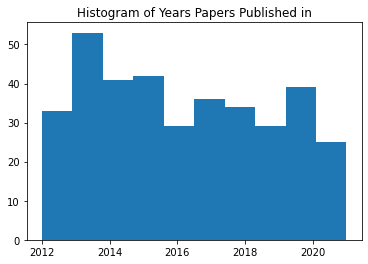

In [ ]:
print_topic_summary('after', 44)

In [ ]:
print_topic_composition('all','after',25,10)

Topic 18.0: 37.87% ['perception', 'sensory', 'perceptual', 'auditory', 'sound'] 

Topic 1.0: 0.93% ['problem', 'account', 'explanation', 'view', 'logic'] 

Topic 25.0: 0.84% ['art', 'technology', 'digital', 'practice', 'aesthetic'] 

Topic 15.0: 0.84% ['action', 'motor', 'goal', 'intention', 'mirror_neuron'] 

Topic 44.0: 0.47% ['interaction', 'context', 'dynamic', 'environment', 'embodied'] 

Topic 11.0: 0.37% ['consciousness', 'conscious', 'state', 'quantum', 'conscious_experience'] 

Topic 38.0: 0.37% ['question', 'answer', 'whether', 'address', 'raise'] 

Topic 16.0: 0.37% ['visual', 'vision', 'image', 'attention', 'eye'] 

Topic 33.0: 0.28% ['mechanism', 'propose', 'attention', 'mechanistic', 'phenomenon'] 

Topic 17.0: 0.28% ['student', 'mathematical', 'mathematics', 'activity', 'understanding'] 



In [ ]:
id_map_topic_words('before','after', 48)

{'ai': [(45, 1), (46, 8), (12, 7)],
 'classical': [],
 'computational': [],
 'connectionism': [],
 'connectionist': [],
 'methodology': [(14, 6)],
 'paradigm': [],
 'symbolic': [(19, 9)],
 'traditional': [],
 'within': []}


---=======Topic 48 in before=======---

=======Topic Keywords=======
['paradigm', 'symbolic', 'ai', 'connectionist', 'computational', 'classical', 'connectionism', 'methodology', 'within', 'traditional']

=======Topic Number of papers=======
404

=======Topic Journals=======
trends in cognitive sciences                  5
minds and machines                            5
kybernetes                                    4
journal of experimental psychology general    3
journal of educational psychology             3
review of general psychology                  3
educational psychology review                 3
ai & society                                  3
behavioral and brain sciences                 3
advances in psychology                        3
dtype: int64

=======Topic Affiliations=======
indiana university                          11
university of california berkeley            9
harvard university                           8
university of michigan                       7
complute

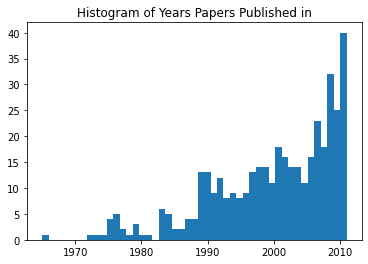

In [ ]:
print_topic_summary('before', 48)

In [ ]:
def print_topic_similarity(topic_type, topic_id, max_count=5, max_words=5):
  if topic_type == "before":
    scores = S.iloc[topic_id,:].sort_values(ascending = False)
    for id2, percent in scores.iloc[:max_count].items():
      print(f"Topic {id2}:","{:.3f}".format(percent), topic_to_keywords["after"][id2][:max_words], '\n')

  elif topic_type == "after":
    scores = S.iloc[:,topic_id].sort_values(ascending = False)
    for id2, percent in scores.iloc[:max_count].items():
      print(f"Topic {id2}:","{:.3f}".format(percent), topic_to_keywords["before"][id2][:max_words], '\n')
  else:
    raise ValueError("topic_type should either be 'before' or 'after'")

## Alluvial Diagrams

In [ ]:
import plotly.graph_objs as go

In [ ]:
fig = px.parallel_categories(topics_df[topics_df.TopicId_all==48].dropna(axis = 0, subset=['TopicId_before']),
                             dimensions = ["Super3_before","Super3_all"],
                             labels = {"Super3_before":"Topics Before 2012","Super3_all":"Topics All"},
                            #  color = "TopicId_before",
                             height = 1000)

fig.update_layout(margin={"r":200,"t":20,"l":200,"b":20}, showlegend=False)
fig.layout.update(showlegend=False)
fig.update(layout_showlegend=False)
fig.show()

In [ ]:
fig = px.parallel_categories(topics_df.dropna(axis = 0, subset=['TopicId_before']),
                             dimensions = ["Super3_before","Super3_all"],
                             labels = {"Super3_before":"Topics Before 2012","Super3_all":"Topics Updated"},
                             color = "TopicId_before",
                             height = 1000)

fig.update_layout(margin={"r":200,"t":20,"l":200,"b":20}, showlegend=False)
fig.layout.update(showlegend=False)
fig.update(layout_showlegend=False)
fig.show()

In [ ]:
fig = px.parallel_categories(topics_df[topics_df.TopicId_before.isna()],
                             dimensions = ["Super3_before","Super3_all"],
                             labels = {"Super3_before":"Topics Before 2012","Super3_all":"Topics Updated"},
                             color = "TopicId_all",
                             title = "Alluvial Diagram for papers after 2021",
                             height = 800)

fig.update_layout(margin={"r":200,"t":50,"l":200,"b":20}, showlegend=False)
fig.layout.update(showlegend=False)
fig.update(layout_showlegend=False)
fig.show()

In [ ]:
fig = px.parallel_categories(topics_df,
                             dimensions = ["TopicKeywords_before","TopicKeywords_all"],
                            #  labels = {"Super3_before 2012":"Topic Before","Super3":"Topic Updated"},
                             color = "TopicId_before",
                             height = 1000)

fig.update_layout(margin={"r":200,"t":20,"l":200,"b":20}, showlegend=False)
fig.layout.update(showlegend=False)
fig.update(layout_showlegend=False)
fig.show()

In [ ]:
fig = px.parallel_categories(topics_df,
                             dimensions = ["TopicKeywords_all","TopicKeywords_after"],
                            #  labels = {"Super3_before 2012":"Topic Before","Super3":"Topic Updated"},
                             color = "TopicId_before",
                             height = 1000)

fig.update_layout(margin={"r":200,"t":20,"l":200,"b":20}, showlegend=False)
fig.layout.update(showlegend=False)
fig.update(layout_showlegend=False)
fig.show()